
# Exploratory Data Analysis on Global Terrorism Data

>By: Soumadip Dey
>
>Email: soumadipdey63@gmail.com

---

The aim of this analysis is to: 
1.   <font color="red"> Come up with interesting questions </font> by analysing the dataset come up with mitigation strategies.
2.   Act as a defence analyst and try to <font color="red">find the hot zone(s)</font> of terrorism.
3.   <font color="red"> Visualize the information </font> in an easily digestable format.

## Introduction 

Terrorism is the use of criminal violence to instill panic or dread, usually with the goal of achieving political or religious objectives. The term primarily refers to purposeful violence against noncombatants during peacetime or during wartime (mostly civilians and neutral military personnel).
<br>

<figure>
  <center>
    <img src='https://drive.google.com/uc?id=1UOCP9fF7aw_wQZEGEy__7Dwhl5THQmbY'/width = 30% height= 30%>
  </center>
</figure>

---

### Terrorism criteria
Only data that satisfies the following three criteria, define an act of terrorism.<br>

**1: POLITICAL, ECONOMIC, RELIGIOUS, OR SOCIAL GOAL**<br>
The violent act must be aimed at attaining a political, economic, religious, or social goal. This criterion is not satisfied in those cases where the perpetrator(s) acted out of a pure profit motive or from an idiosyncratic personal motive unconnected with broader societal change

**2: INTENTION TO COERCE, INTIMIDATE OR PUBLICIZE TO LARGER AUDIENCE(S)**<br>
To satisfy this criterion there must be evidence of an intention to coerce, intimidate, or convey some other message to a larger audience (or audiences) than the immediate victims. Such evidence can include (but is not limited to) the following: pre‐ or post‐attack statements by the perpetrator(s), past behavior by the perpetrators, or the particular nature of the target/victim, weapon, or attack type.

**3: OUTSIDE INTERNATIONAL HUMANITARIAN LAW**<br>
The action is outside the context of legitimate warfare activities, insofar as it targets non‐combatants (i.e. the act must be outside the parameters permitted by international humanitarian law as reflected in the Additional Protocol to the Geneva Conventions of 12 August 1949 and elsewhere).

## Preliminary Tasks and Data Preparation

**Importing required packages, loading the dataset and cleaning the dataset(if required)**

**Importing required packages**

In [ ]:
%pip install matplotlib==3.4.0 folium mapclassify geopandas click==7.1.2 plotly==5.12.0 --quiet

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib
import geopandas as gpd
from pathlib import Path

print(matplotlib.__version__)

3.4.0


In [ ]:
import plotly.express as px
import plotly.colors as colors

**Loading the Dataset**

In [ ]:
!wget https://github.com/SoumadipDey/datasets/raw/main/GlobalTerrorism.zip --quiet
!unzip GlobalTerrorism.zip

Archive:  GlobalTerrorism.zip
replace globalterrorismdb_0718dist.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: globalterrorismdb_0718dist.csv  


In [ ]:
main_df = pd.read_csv('globalterrorismdb_0718dist.csv', encoding = "ISO-8859-1", low_memory=False)
print(f"There are {len(main_df.columns)} columns in the dataset!")
print(f"There are {len(main_df)} rows in the dataset!")

There are 135 columns in the dataset!
There are 181691 rows in the dataset!


There are a lot of columns in this dataset but for our EDA , we can refer to this [Codebook](https://www.start.umd.edu/gtd/downloads/Codebook.pdf) for information regarding the various columns.

**Extracting the columns needed for Analysis**

In [ ]:
data_columns = [
    'eventid', # Unique ID for a row. No analytic or predictive power, but used in some plotting functions.

    'iyear', 'imonth', 'latitude', 'longitude',

    'crit1', 'crit2', 'crit3', # The incident meets the criterion (1, 2, 3), described in the introduction.
    'doubtterr', # Is there doubt to wether the attack is an act of terrorism?
    'success', # Has the attack reached its goal? Depends on type of attack.
    'suicide', # Did the perpetrator intend to escape alive?  

    'nkill', # Amount of confirmed kills.
    'nwound', # Amount of confirmed wounded.

    'country_txt', # Name of country.
    'region', # Region id.
    'region_txt', # Name of region.
    'city',
    'attacktype1_txt', # Of what type was the attack? I.e. assassination, bombing or kidnapping.
    'targtype1_txt', # What target did the attack have? I.e. business, government or police.
    'natlty1_txt', # Nationality of the target.
    'weaptype1_txt', # What weapon was used?
    'motive', # The specific motive for the attack

    'gname', # Name of the organized group, if applicable.
    'summary', # Summary of the attack.
]

In [ ]:
main_df = main_df[data_columns]
main_df.isna().sum()

eventid                 0
iyear                   0
imonth                  0
latitude             4556
longitude            4557
crit1                   0
crit2                   0
crit3                   0
doubtterr               1
success                 0
suicide                 0
nkill               10313
nwound              16311
country_txt             0
region                  0
region_txt              0
city                  434
attacktype1_txt         0
targtype1_txt           0
natlty1_txt          1559
weaptype1_txt           0
motive             131130
gname                   0
summary             66129
dtype: int64

**Notes:**

There seem to be a lot of missing values in the dataset, some furthur analysis and data cleaning is required.

**Observations and Mitigations:**

1.   One missing value in ``doubtterr``, mitigate by dropping record.
2.   ``nkill`` and ``nwound`` have many missing records, mitigate by replacing with median values.
3.   ``natlty1_txt`` missing values , mitigate by replacing with 'Unknown'.
4.   ``latitude``, ``longitude`` missing values values, mitigate by dropping said records.
5.   Many missing values in ``motive``, replace with 'Unknown'.
6.   In ``summary`` there are many missing values, replace with 'Unknown'.




**Data Cleaning**

In [ ]:
# Removing random acts of violence and only keeping the entries which match 3 criterias
main_df = main_df[(main_df.crit1 == 1) & (main_df.crit2 == 1) & (main_df.crit3 == 1) & (main_df.doubtterr == 0)]

In [ ]:
main_df.shape

(138879, 24)

In [ ]:
# Remove crit1,crit2,crit3 and doubtterr columns as they are no longer required
main_df.drop(['crit1', 'crit2', 'crit3', 'doubtterr'],axis = 1, inplace = True)

In [ ]:
# Searching for inconsistent values within the discrete columns
# It'll make our job easier
search_cols = ['success','suicide', 'region','region_txt', 'weaptype1_txt',
               'attacktype1_txt', 'targtype1_txt','gname'] # Columns with discrete values
for col in search_cols:
  print(f"{col} -> values: {pd.unique(main_df[col])}\n")

success -> values: [1 0]

suicide -> values: [0 1]

region -> values: [ 2  1  5  8  3  9 11 10  4 12  6  7]

region_txt -> values: ['Central America & Caribbean' 'North America' 'Southeast Asia'
 'Western Europe' 'South America' 'Eastern Europe' 'Sub-Saharan Africa'
 'Middle East & North Africa' 'East Asia' 'Australasia & Oceania'
 'South Asia' 'Central Asia']

weaptype1_txt -> values: ['Unknown' 'Explosives' 'Firearms' 'Incendiary' 'Chemical' 'Melee'
 'Sabotage Equipment'
 'Vehicle (not to include vehicle-borne explosives, i.e., car or truck bombs)'
 'Fake Weapons' 'Radiological' 'Other' 'Biological']

attacktype1_txt -> values: ['Assassination' 'Hostage Taking (Kidnapping)' 'Bombing/Explosion'
 'Armed Assault' 'Facility/Infrastructure Attack' 'Hijacking'
 'Unarmed Assault' 'Hostage Taking (Barricade Incident)' 'Unknown']

targtype1_txt -> values: ['Private Citizens & Property' 'Government (Diplomatic)'
 'Journalists & Media' 'Police' 'Military' 'Government (General)'
 'Educational In

As it can be observed from the output, there is no major inconsistency in the categorical values.


In [ ]:
# Changing some missing values in text type columns to "Unknown"
main_df['natlty1_txt'].fillna('Unknown', inplace = True)
main_df['motive'].fillna('Unknown', inplace = True)
main_df['summary'].fillna('Unknown', inplace = True)
main_df['city'].fillna('Unknown', inplace = True)

In [ ]:
# Weapontype column contains very long value for Vehicle property -> shorten.
main_df['weaptype1_txt'].replace('Vehicle (not to include vehicle-borne explosives, i.e., car or truck bombs)', 'Vehicle', inplace = True)

In [ ]:
# Some nwound and nkill are NaN. Replace them with median.
main_df['nkill'] = np.round(main_df['nkill'].fillna(main_df['nkill'].median())).astype(int)
main_df['nwound'] = np.round(main_df['nwound'].fillna(main_df['nwound'].median())).astype(int)

print("Data cleaned and prepared.\n")
main_df.info()

Data cleaned and prepared.

<class 'pandas.core.frame.DataFrame'>
Int64Index: 138879 entries, 0 to 181690
Data columns (total 20 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   eventid          138879 non-null  int64  
 1   iyear            138879 non-null  int64  
 2   imonth           138879 non-null  int64  
 3   latitude         136000 non-null  float64
 4   longitude        136000 non-null  float64
 5   success          138879 non-null  int64  
 6   suicide          138879 non-null  int64  
 7   nkill            138879 non-null  int64  
 8   nwound           138879 non-null  int64  
 9   country_txt      138879 non-null  object 
 10  region           138879 non-null  int64  
 11  region_txt       138879 non-null  object 
 12  city             138879 non-null  object 
 13  attacktype1_txt  138879 non-null  object 
 14  targtype1_txt    138879 non-null  object 
 15  natlty1_txt      138879 non-null  object 
 16  weaptype1_

In [ ]:
# Dropping rows containing missing longitude and latitude values
main_df.dropna(inplace=True)

In [ ]:
main_df.isna().sum()

eventid            0
iyear              0
imonth             0
latitude           0
longitude          0
success            0
suicide            0
nkill              0
nwound             0
country_txt        0
region             0
region_txt         0
city               0
attacktype1_txt    0
targtype1_txt      0
natlty1_txt        0
weaptype1_txt      0
motive             0
gname              0
summary            0
dtype: int64

In [ ]:
main_df.shape

(136000, 20)

In [ ]:
filepath = Path('content/ProcessedTerrorData.csv')  
filepath.parent.mkdir(parents=True, exist_ok=True)  
main_df.to_csv(filepath)  

## Exploratory Analysis

**Questions and Observations:**
1. Amount and success rates of attacks during recent years.
2. Success Rates per Region and the Regionwise Attack Trends.
3. What are the most popular targets of terrorist attacks?
4. Which attack types are popular?
5. What weapons are being used to carry out these attacks?
6. Activity rates and casualties of terrorist groups over time.
7. Spread of terrorist attacks throughout the world with time.
8. Most affected cities and countries of terrorist attacks.
9. Regions of Attackes by known terrorist groups. 
10. Hotzones of terrorism over time.




### **1) <font color='red'>Trend in terrorist activities</font> and <font color='red'>Success Rate</font> of attacks during recent years**

In [ ]:
#@title Calculating / gathering the relevant data.
yearly_attack_counts = main_df.groupby('iyear')['eventid'].count()
yearly_attack_success = main_df.groupby('iyear')['success'].sum()
success_rates = round((yearly_attack_success / yearly_attack_counts) * 100,2)

#Additional step for settting a new max value for y-axis
max_y_lim = max(yearly_attack_counts.to_numpy()) + 0.20 * max(yearly_attack_counts.to_numpy())

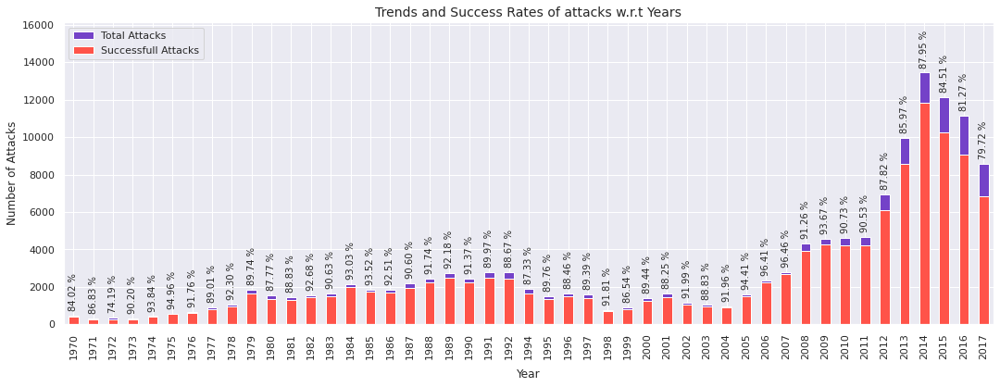

In [ ]:
#@title Plotting the information in a bar chart.
sns.set_theme()
fig, ax = plt.subplots(figsize=(18,6))
yearly_attack_counts.plot.bar(color = sns.colors.crayons['Purple Heart'], label = 'Total Attacks' , ax = ax)
yearly_attack_success.plot.bar(color = sns.colors.crayons['Red Orange'], label = 'Successfull Attacks', ax = ax)
plt.bar_label(container = ax.containers[0], labels= ['%.2f %%' % rate for rate in success_rates.to_numpy()],
              padding = 5, fontsize= 10, label_type='edge',
              rotation = 90)
plt.ylim(0, max_y_lim)
plt.xlabel('Year', fontdict={"fontsize": 12}, labelpad = 10)
plt.ylabel('Number of Attacks', fontdict={"fontsize": 12})

plt.legend(loc='upper left')
plt.title("Trends and Success Rates of attacks w.r.t Years", fontdict={"fontsize": 14})
plt.show()

**Observations:**

1. The number of terrorist attacks have seen an exponential growth in the recent years.

2. Although the number of the attacks seem to be increasing, there has not been significant change in the success rates of the attacks being carried out.

### **2) <font color='red'> Success Rates per Region </font> and the <font color='red'> Regionwise Attack Trends </font>**

In [ ]:
#@title Calculating / gathering the relevant data.
success_region = main_df.groupby('region_txt')['success'].agg(Count='count', Sum='sum')
success_region['success_rate'] = round((success_region['Sum'] / success_region['Count'])*100, 2)
success_region.rename(columns = {'Count':'Attacks', 'Sum':'Success'}, inplace = True)
success_region.reset_index(level=0, inplace=True)
success_region.sort_values(by = 'Attacks', ascending = True, inplace= True)

# Additional step for settting a new max value for y-axis
max_x_lim = max(success_region['Attacks'].to_numpy()) + 0.12 * max(success_region['Attacks'].to_numpy())

In [ ]:
#@title Calculating the number of incidents per region w.r.t years
incident_year_region = main_df.groupby(['iyear','region_txt'])['eventid'].agg(Count = 'count')
incident_year_region.reset_index(inplace = True)

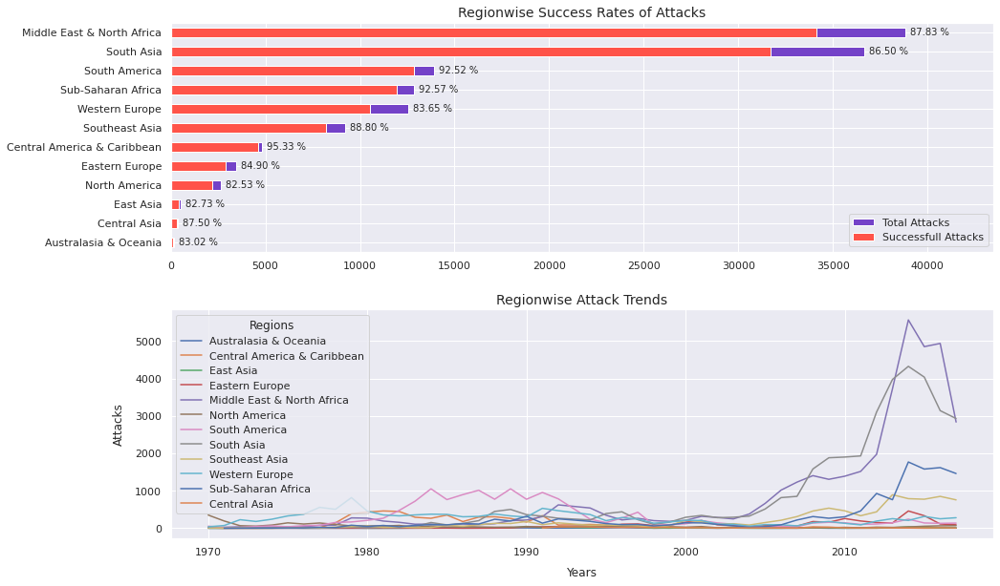

In [ ]:
#@title Plotting the information.
fig, ax = plt.subplots(2,1,figsize=(15,9))
success_region.plot.barh(x = 'region_txt', y = 'Attacks', color = sns.colors.crayons['Purple Heart'],
                         label = 'Total Attacks', 
                         ax = ax[0])
success_region.plot.barh(x = 'region_txt', y = 'Success', color = sns.colors.crayons['Red Orange'], 
                         label = 'Successfull Attacks', 
                         ax = ax[0])
ax[0].bar_label(container = ax[0].containers[0], labels= ['%.2f %%' % rate for rate in success_region['success_rate'].to_numpy()],
              padding = 5, fontsize= 10, label_type='edge')
ax[0].set_ylabel(None)
ax[0].set_xlim(0, max_x_lim)
ax[0].set_title("Regionwise Success Rates of Attacks", fontdict={"fontsize": 14}) 
ax[0].legend(loc='lower right')

sns.lineplot(data = incident_year_region , x = 'iyear', y = 'Count', hue = 'region_txt', 
             palette = sns.color_palette(n_colors = len(pd.unique(incident_year_region['region_txt']))),
             ax = ax[1])
ax[1].set_xlabel('Years', fontdict={"fontsize": 12}, labelpad = 10)
ax[1].set_ylabel('Attacks', fontdict={"fontsize": 12}, labelpad = 10)
ax[1].set_title("Regionwise Attack Trends", fontdict={"fontsize": 14}) 
ax[1].legend(title='Regions',)

fig.tight_layout(pad = 2)
fig.show()

**Observations:**

1.   The terrorist attacks in Central America, South America and Sub-Saharan Africa have the highest success rates.
2.   Middle East, North Africa and South Asia have the highest rate of terrorist attacks.
3.   Over recent years (2000 - 2017),  Middle Eastern, African and South Asian nations have seen exponential growth in attacks.



### **3) What are the <font color='red'> most popular targets </font> of terrorist attacks?**

In [ ]:
#@title Calculating / gathering the relevant data.
target_counts = main_df.groupby('targtype1_txt')['targtype1_txt'].agg(Count = 'count').reset_index()
target_counts.sort_values(by = 'Count', ascending = False, inplace = True)

In [ ]:
#@title Plotting the information in a treemap.
fig = px.treemap(target_counts, path = [px.Constant("Target"), "targtype1_txt"],
                 values = 'Count', color  = 'Count',
                 color_continuous_scale = 'Fall',
                )
fig.update_layout(title=dict(text="Most Popular Targets of Terrorist Attacks", x= 0.07),
                  title_font= dict(family = 'Arial', size = 16),
                  font = dict(size = 14, family = 'Verdana'), 
                  width  = 1100, height = 500)
fig.update_layout(coloraxis_colorbar=dict(title="No. of Attacks "))
fig.data[0].marker.colors[-1] = None
fig.data[0].textinfo = 'label + percent parent'
fig.data[0].hovertemplate = '%{label}<br>Attacks: %{value}'
fig.data[0].texttemplate = "%{label}<br>Attacks: %{value}<br>%{percentRoot}"
fig.show()

**Observations:**

1. Private Citizens and Property, Police , Government and Businesses are the most common targets of terrorist attacks. 

2. Apart from that military, transportation and Utilities such as power grids or water supply are also major targets.

### **4) Which are the <font color='red'> popular attack types </font>?**

In [ ]:
#@title Plotting the information in a histogram
fig = px.histogram(main_df, x = 'attacktype1_txt',
                   color = 'attacktype1_txt')
fig.update_layout(title = dict(text="Popular Attack Types", x= 0.07),
                  title_font = dict(family = 'Arial', size = 16),
                  font = dict(size = 12, family = 'Verdana'),
                  legend = dict(title = 'Attack Type:'), 
                  xaxis_title=None, yaxis_title="No. of Attacks",
                  width  = 1100, height = 500,
                  )
fig.update_layout(barmode='stack', xaxis={'categoryorder': 'total descending'})
fig.update_traces(texttemplate='%{y}', textposition='auto')
fig.update_traces(hovertemplate = 'Attack Type : %{x}<br>Count= %{y}')
fig.update_layout(uniformtext_minsize = 8, uniformtext_mode='show')
fig.show()

**Observations:**

1. Bombing / Explosions are  the most frequent form of attacks followed by armed assaults and assasinations.



### **5) <font color='red'> Which weapons are being used </font> to carry out these attacks?**

In [ ]:
#@title Plotting the information in a histogram
fig = px.histogram(main_df, x = 'weaptype1_txt',
                   color = 'weaptype1_txt')
fig.update_layout(title = dict(text="Popular Weapon Types", x= 0.07),
                  title_font = dict(family = 'Arial', size = 16),
                  font = dict(size = 12, family = 'Verdana'),
                  legend = dict(title = 'Weapon Type:'), 
                  xaxis_title=None, yaxis_title="No. of Attacks",
                  width  = 1100, height = 500,
                  )
fig.update_layout(barmode='stack', xaxis={'categoryorder': 'total descending'})
fig.update_traces(texttemplate='%{y}', textposition='auto')
fig.update_traces(hovertemplate = 'Weapon : %{x}<br>Count= %{y}')
fig.update_layout(uniformtext_minsize = 8, uniformtext_mode='show')
fig.show()

**Observations:**

1.   Explosives and Firearms are the most commonly used weapons for the attacks.
2.   This observation correlates with our previous observation about the type of attacks. ``Bombings/Explosion`` requires ``Explosives`` , ``Armed Assaults`` or ``Assassinations`` both require ``Firearms``.



### **6) <font color='red'> Activity rates </font> and <font color='red'> Notoriety </font> of known terrorist groups.**

In [ ]:
#@title Calculation and transformation of relevant information.
notoriety_df = main_df.groupby('gname').agg({'nkill':['sum'], 'nwound':['sum']}).reset_index()
notoriety_df['total'] = notoriety_df['nkill'] + notoriety_df['nwound']
notoriety_df.sort_values(by = 'total', ascending = False, inplace = True)
notoriety_df = notoriety_df.where(notoriety_df.gname != "Unknown").dropna().nlargest(30,'total').rename(columns={'nkill': 'Killed', 'nwound': 'Wounded'})
notoriety_df = pd.melt(
    frame = notoriety_df.drop('total', axis = 1).reset_index(drop=True),
    id_vars = "gname",
    col_level = 0,
    value_vars = ['Killed','Wounded'],
    var_name = 'Type',
    value_name='Sum'
)
activity_rate = pd.crosstab(main_df['gname'],main_df['iyear'],main_df['nkill'] + main_df['nwound'],aggfunc='sum').fillna(0)
activity_rate = pd.DataFrame(pd.melt(frame = activity_rate.reset_index(), id_vars = "gname", col_level = 0,
                                     var_name = 'Year', value_name='Casualties'))
activity_rate = activity_rate.loc[activity_rate['gname'].isin(notoriety_df['gname'].unique())].reset_index(drop = True)

/usr/local/lib/python3.8/dist-packages/pandas/core/generic.py:4150: PerformanceWarning:

dropping on a non-lexsorted multi-index without a level parameter may impact performance.



In [ ]:
#@title Plotting the information.
fig = px.treemap(notoriety_df, 
                 path = [px.Constant("All"), "gname", "Type"], 
                 values = 'Sum', color  = 'Sum', 
                 color_continuous_scale = 'Fall',
                 maxdepth = 2
                )
fig.update_layout(title=dict(text="Notoriety of Top 30 Known Terrorist Groups", x= 0.07),
                  title_font= dict(family = 'Arial', size = 16),
                  font = dict(size = 14, family = 'Verdana'), 
                  width  = 1100, height = 500)
fig.update_layout(coloraxis_colorbar=dict(title="No. of Casualties "))
fig.data[0].marker.colors[-1] = None
fig.data[0].textinfo = 'label + percent parent'
fig.data[0].hovertemplate = '%{label}<br>Casualties: %{value}'
fig.data[0].texttemplate = "%{label}<br>Casualties: %{value}<br>%{percentRoot} of all casualties!"
fig.show()

**Observations:**

1.   The treemap lets us observe the casualty rates of most notorious terrorist groups. ```Casualties = No. of Kills + No. of Wounded```
2.   The **ISIL/ISIS** and its derivatives, **Taliban** and its derivatives, **Al-Qaida** and its derivatives and **Boko Haram** are the most notorious terrorist groups who committed atrocities resulting in almost 60% of the casualties by known terrorist organizations.



In [ ]:
#@title Plotting Activity Trend of known terrorist groups w.r.t time and Casualties
fig = px.line(activity_rate, x = "Year", y = "Casualties", color = "gname", custom_data=['gname'], markers=True)
fig.update_layout(title = dict(text="Activity Rate of Top 30 Notorious Terrorist Organizations", x= 0.07),
                  title_font = dict(family = 'Verdana', size = 16),
                  font = dict(size = 12, family = 'Verdana'),
                  legend = dict(title = 'Group Name:'),
                  width  = 1100, height = 500)
fig.update_traces(hovertemplate = '<b>%{customdata[0]}</b><br>Year: %{x}<br>Casualties: %{y}<extra></extra>')
fig.show()

**Observations:** 

1.   The **Al-Qaida** were the most active during **1998 - 2004** causing the 9/11 terrorist attacks of 2001 on the twin towers in New York City, USA. After this period the core group's activity decreased wheras the activity of its derivatives increased.

2.   The **Boko Haram** , a relatively new terrorist organization from Nigeria were the most active during **2010 - 2016**, commiting attrocities in and around the country.

3.   The **Taliban** , terrorist organization from Afgahnistan grew to power in the late 90's during the afgan civil war and were the most active during **2005 - 2016**. They have close ties with Al-Qaida and even allowed refuge to Al-Qaida leaders such as **Osama bin Laden** and refused to give him up to the US, thus resulting in them becoming a target of the US.

4. The **ISIL/ISIS** are also a relatively new terrorist organization from Iraq and Syria they were most active during **2013 - 2017** and are the most notorious terrorist group in recent history. They originated during the Iraq War from the remains of Al-Qaida in Iraq.





### **7) <font color='red'> Spread of terrorist attacks </font> throughout the world over time.**

The next few visualizations use geographical data , so some additional information needs to be added to our dataset which will make the visualization process easier.

Some additional metrics such as ``Attack Size Factor`` 
are also implemented to help plot the information consistently. It is calculated according to the following conditions. ```Attack Intensity``` on the other hand represents a categorical attack intensity level.

1. Casualties <= 50
    * Attack Size Factor = 1
    * Attack Intensity = 1
2. Casualties > 50 and <= 100
    * Attack Size Factor = 5
    * Attack Intensity = 2
3. Casualties > 100 and <= 500
    * Attack Size Factor = 12
    * Attack Intensity = 3
4. Casualties >= 500
    * Attack Size Factor = 25
    * Attack Intensity = 4




In [ ]:
#@title Additional information embedding.

# Replacing some values with updated values for parity
main_df.replace('East Germany (GDR)', 'Germany', inplace=True)
main_df.replace('West Germany (FRG)', 'Germany', inplace=True)
main_df.replace('South Yemen', 'Yemen', inplace=True)
main_df.replace('North Yemen', 'Yemen', inplace=True)
main_df.replace('South Vietnam', 'Vietnam', inplace=True)
main_df.replace('Zaire', 'Democratic Republic of the Congo', inplace=True)
main_df.replace('People\'s Republic of the Congo', 'Republic of the Congo', inplace=True)
main_df.replace('West Bank and Gaza Strip', 'West Bank', inplace=True)
main_df.replace('New Hebrides', 'Vanuatu', inplace=True)
main_df.replace('Rhodesia', 'Zimbabwe', inplace=True)
main_df.replace('Slovak Republic', 'Slovakia', inplace=True)
main_df.replace('Western Sahara', 'Morocco', inplace=True)
main_df.replace('East Timor', 'Indonesia', inplace=True)

# Loading the dataset with country codes and performing a left join with the main dataset.
country_df = pd.read_csv("https://raw.githubusercontent.com/SoumadipDey/datasets/main/CountryCodes.csv")

geo_main = pd.merge(main_df, country_df, how='left', left_on='country_txt', right_on='Country')
geo_main.rename({'nkill':'Killed',
                 'nwound':'Wounded',
                 'iyear': 'Year',
                 'imonth': 'Month',
                 'gname': 'Group',
                 'city': 'City',
                 'region_txt': 'Region'}, axis = 1, inplace = True)
geo_main.drop(['country_txt'], axis = 1, inplace = True)
geo_main['Casualties'] = geo_main['Killed'] + geo_main['Wounded']

In [ ]:
#@title Calculating attack size factor based on casualties.
conditions = [
    (geo_main['Casualties'] <= 50),
    (geo_main['Casualties'] > 50) & (geo_main['Casualties'] <= 100),
    (geo_main['Casualties'] > 100 ) & (geo_main['Casualties'] <= 500),
    (geo_main['Casualties'] >= 500)]
factors = [1, 5, 12, 25]
types = [1, 2, 3, 4]
geo_main['Attack Size Factor'] = np.select(conditions, factors, default = 1)
geo_main['Attack Intensity'] = np.select(conditions, types, default = 1)

In [ ]:
#@title Plotting the information
fig = px.scatter_geo(geo_main, lat="latitude", lon="longitude", hover_name="City", 
                        hover_data=["Group","Casualties"],
                        size = "Attack Size Factor",
                        color = "Attack Size Factor",
                        animation_frame="Year",
                        color_continuous_scale='Bluered',
                        projection="natural earth",
                        width=1100 , height=500)
fig.update_layout(title = dict(text="Spread of terrorist attacks over time.", x= 0.5),
                  title_font = dict(family = 'Verdana', size = 16),
                  font = dict(size = 12, family = 'Verdana'),
                  )
fig.update_geos(
    showcountries=True,
)
fig.show()

**Observations:**


1.   Over time the terrorist attacks become more frequent and have higher casualties.
2.   The major terrorist attack incidents such as the September 11, 2001 attacks on the Twin Towers or the November 26, 2006 Mumbai attacks and many others are vizualized on this chart with their related information.



### **8) Top 50 <font color='red'> Most affected cities </font> and <font color='red'> Casualties per country </font> of the terrorist attacks.**

In [ ]:
#@title Gathering the required information
aff_cities = geo_main.groupby(['Country',
                               'City']).agg({'Casualties':'sum',
                                             'latitude':'mean',
                                             'longitude':'mean'}).reset_index().nlargest(40,'Casualties').reset_index(drop = True)
country_casualties = geo_main.groupby(['Country',
                                       'Codes']).agg({'Casualties':'sum',
                                                      'Killed':'sum',
                                                      'Wounded':'sum'}).reset_index()

In [ ]:
#@title Plotting the information.
fig = px.choropleth(country_casualties, locations="Codes",
                    color = "Casualties", 
                    hover_name = "Country",
                    hover_data = ['Killed','Wounded'],
                    color_continuous_scale = 'matter',
                    projection="orthographic",
                    width=1100 , height=500)
fig.update_layout(title = dict(text="Top 50 Most Affected Cities and Casualties per country", x= 0.5),
                  title_font = dict(family = 'Verdana', size = 16),
                  font = dict(size = 12, family = 'Verdana'),
                  )

fig2 = px.scatter_geo(aff_cities, lat = 'latitude', lon = 'longitude', size = 'Casualties', hover_name="City", projection="orthographic",
                      width=1100 , height=500)
fig.add_trace(
    fig2.data[0]
)
fig.show()

**Observations:**

1.   <font color = 'red'>Iraq is the country most affected by terrorism, followed by Afghanistan, Pakistan, India, Sri Lanka and Nigeria </font>. These countries are from the Middle East, South Asian and Sub Saharan African regions and correlate to our earlier observations about the terrorist attack trends over the aforementioned regions.
2.   In accordance to the previous point, <font color = 'red'> Baghdad City in Iraq is the worst affected </font> with nearly 76 thousand casualties over the years due to terrorist attacks followed by <font color = 'red'> New York City </font> and other cities commonly targetted by terrorists.



### **9) <font color='red'> Regions Attacked </font> by Top 30 Notorious terrorist groups.**

In [ ]:
#@title Plotting the information
fig = px.scatter_geo(geo_main.where(geo_main['Group'].isin(notoriety_df['gname'].unique())).dropna(), 
                     lat = "latitude", lon = "longitude", hover_name = "City",
                     hover_data = ['Year','Casualties'],
                     color = "Group",
                     projection="natural earth",
                     width=1100 , height=500)
fig.update_layout(title = dict(text="Region of attack of known terrorist groups", x= 0.5),
                  title_font = dict(family = 'Verdana', size = 16),
                  font = dict(size = 12, family = 'Verdana'),
                  )
fig.update_geos(
    showcountries=True,
)
fig.show()

**Observations:**


1.   The map shows the attack patterns of the regionally active known terrorist organizations.
2.   It can be seen that the ISIS and Taliban are most active in the middle eastern Countries, Afghanistan and Pakistan.
3.   An interesting pattern about Al-Qaida and its derivatives emerges that their attacks are spread out over multiple countries and multiple regions.
4.   The Irish Republican Party is another such terrorist organization which has attacks spread out over most European nations as well as a few in Africa and America.



### **10) <font color='red'> Hotzones of terrorism </font> over time**



In [ ]:
#@title Plotting the information
fig = px.density_mapbox(geo_main, 
                        lat = "latitude", lon = "longitude",z = "Attack Intensity",
                        hover_name = 'Region',
                        color_continuous_scale = 'matter',
                        animation_frame = 'Year',
                        radius = 10, zoom = 1, width = 1100, height = 500)
fig.update_layout(mapbox_style = "open-street-map", mapbox_center_lon = 0)
fig.update_layout(title = dict(text="Hotzones of terrorism over time", x= 0.5),
                  title_font = dict(family = 'Verdana', size = 16),
                  font = dict(size = 12, family = 'Verdana'),
)
fig.show()

**Observations:**

1.   The changing **Hotzones of Terrorism** over time can be visualized through this map.
2.   It can be observed that in the recent years, various countries such as Iraq, Afghanistan, Pakistan hve become the hotzones of terrorism.



### **Summary**

> From the exploratory data analysis, Middle East and South Asia clearly have the highest levels of terrorist activity, both in terms of numbers and casualties. 
>
> It can also be seen that terrorism is widespread throughout the world, many lives have been lost over the years due to the attacks of various terrorist groups. In recent years, India, Pakistan, and Afghanistan have seen an upsurge in the frequency of such operations.
> 
> The governments of the affected nations as well as the UN, and multiple other global alliances are taking measures to understand the spread and take necessary preventive or offensive actions against the terrorist organizations.